In [13]:
import os
import sys
import matplotlib.pyplot as plt
import numpy as np
from PIL import Image
from pdf2image import convert_from_path
import cv2
from pathlib import Path
from tqdm import tqdm
import math
import pdfplumber
import pytesseract as pyt
import tempfile
%matplotlib inline

In [14]:
test_name = "2017_11"
data_dir = Path("../data/")
raw_dir = data_dir/"raw"
pdf_dir = data_dir/"pdf"
output_dir = data_dir/"output"
pdf_path = pdf_dir/(test_name+".pdf")
png_dir = raw_dir/test_name

In [17]:
output_dir

'/var/folders/3m/w3td4zd545g6m987tcxfl0k40000gn/T/tmppjp60o2j'

In [3]:
# pdf to png
pages = convert_from_path(str(pdf_path))
pdflen = len(pages)
if pages:
    print("convert done")
if not os.path.exists(png_dir):
    os.mkdir(png_dir)
    print(f"mkdir {png_dir}")
for i, page in enumerate(pages):
    png_path = png_dir/(str(i)+".png")
    if not os.path.exists(png_path):
        page.save(str(png_path), "PNG")

convert done


In [514]:
def imshow(img, figsize=(20,20)):
    fig, ax= plt.subplots(1,1, figsize=figsize)
    ax.imshow(img, cmap="gray")

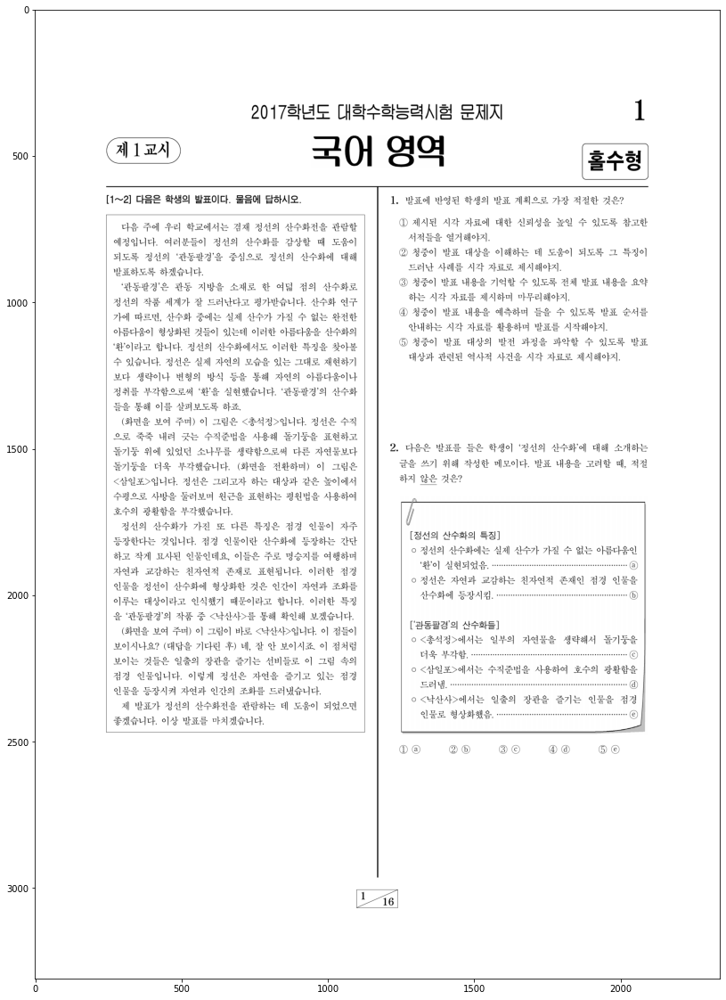

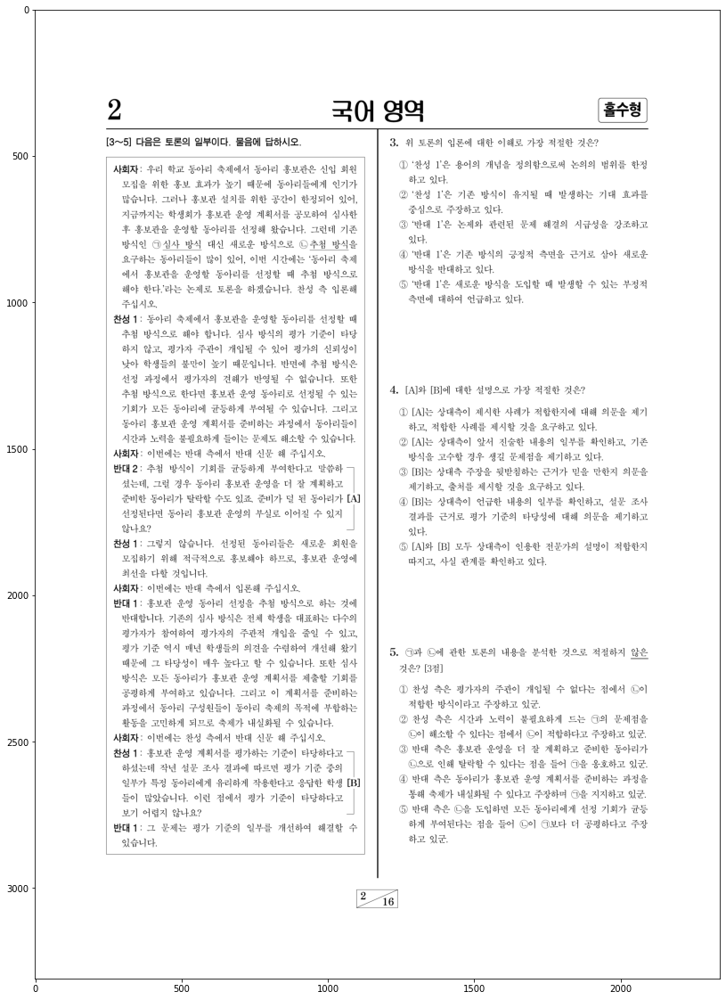

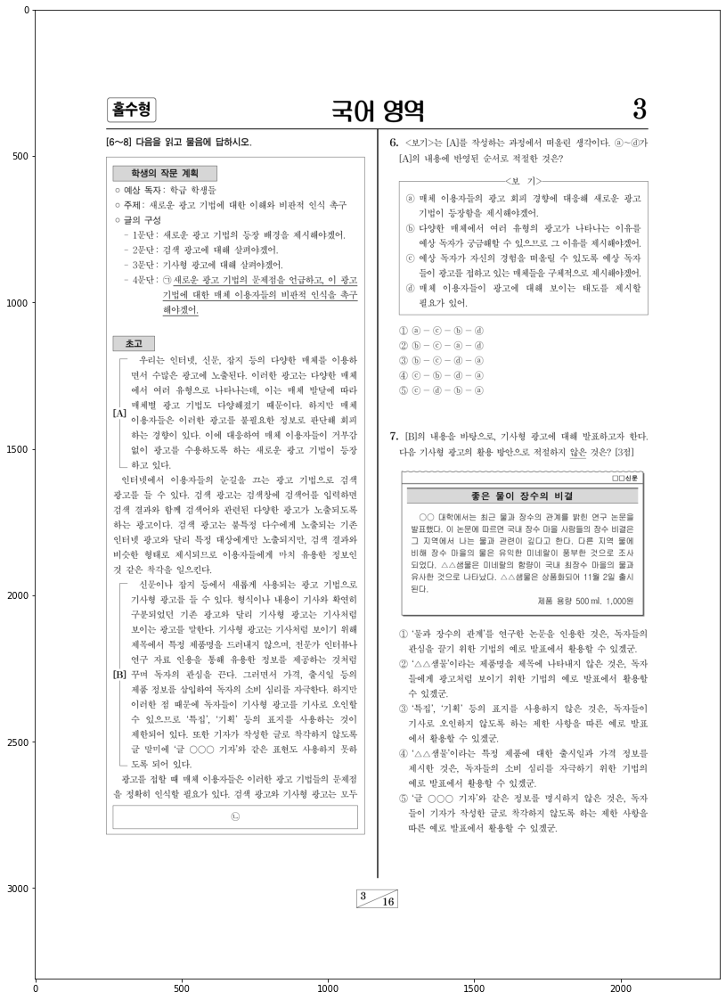

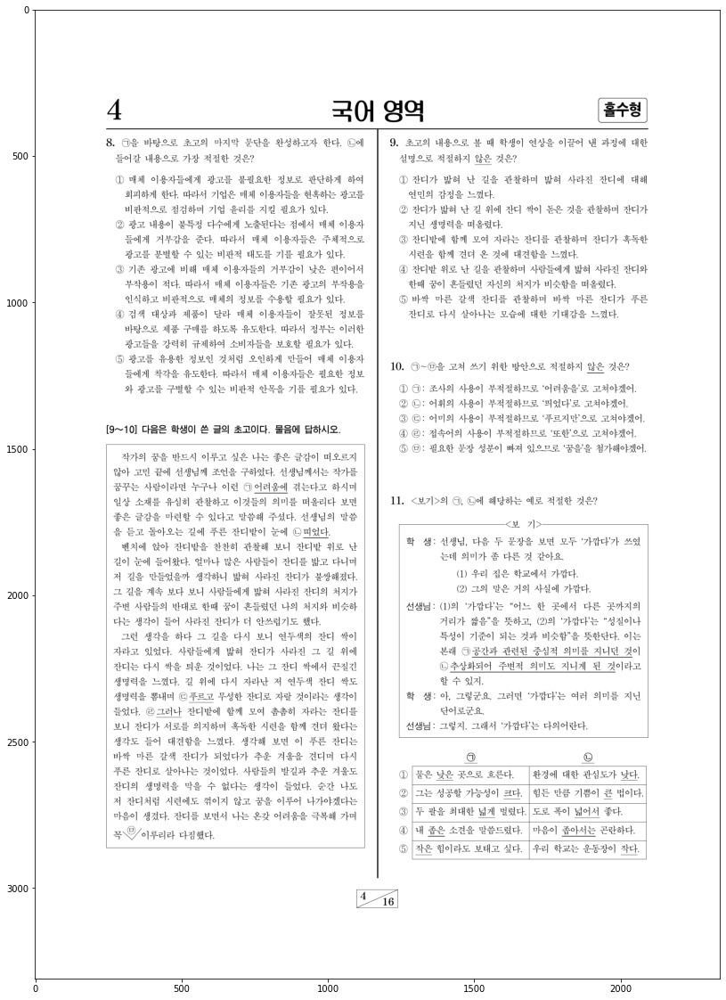

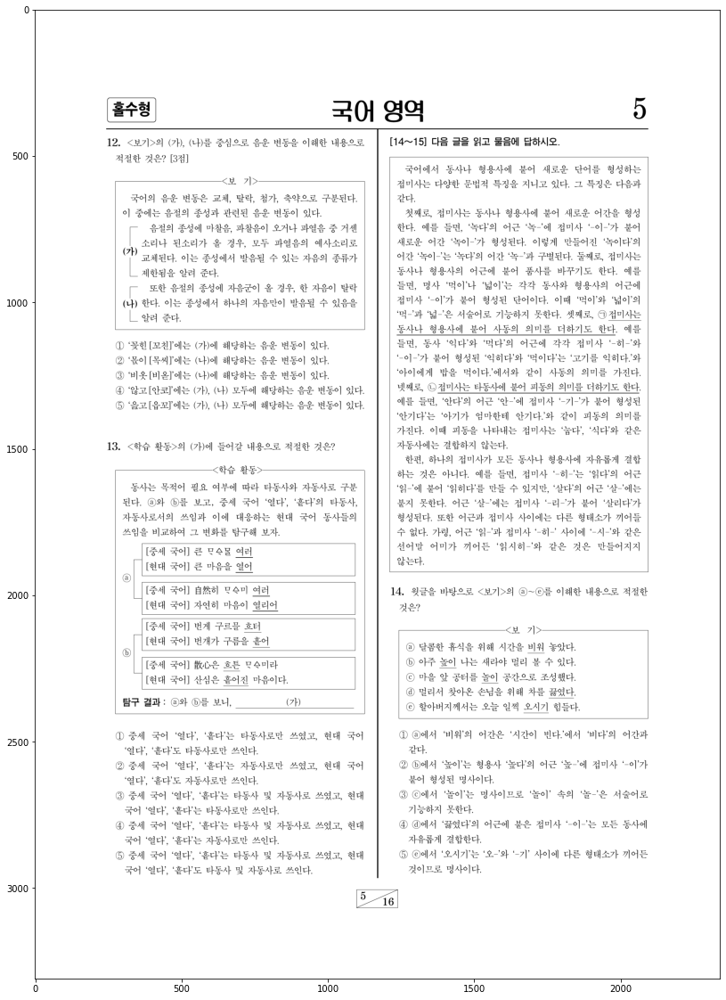

...

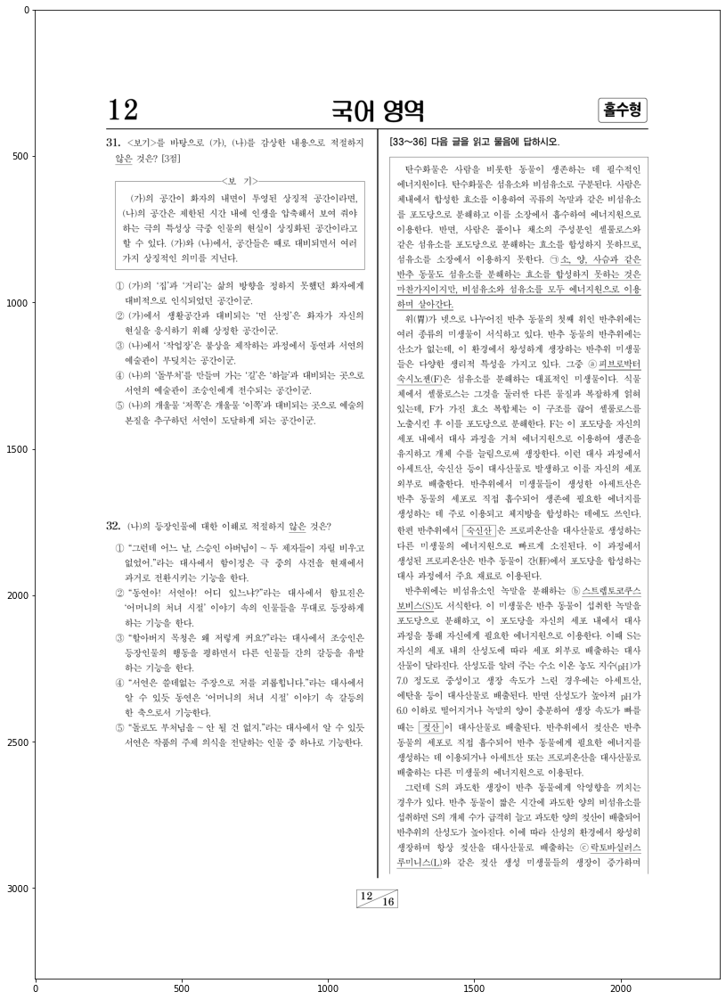

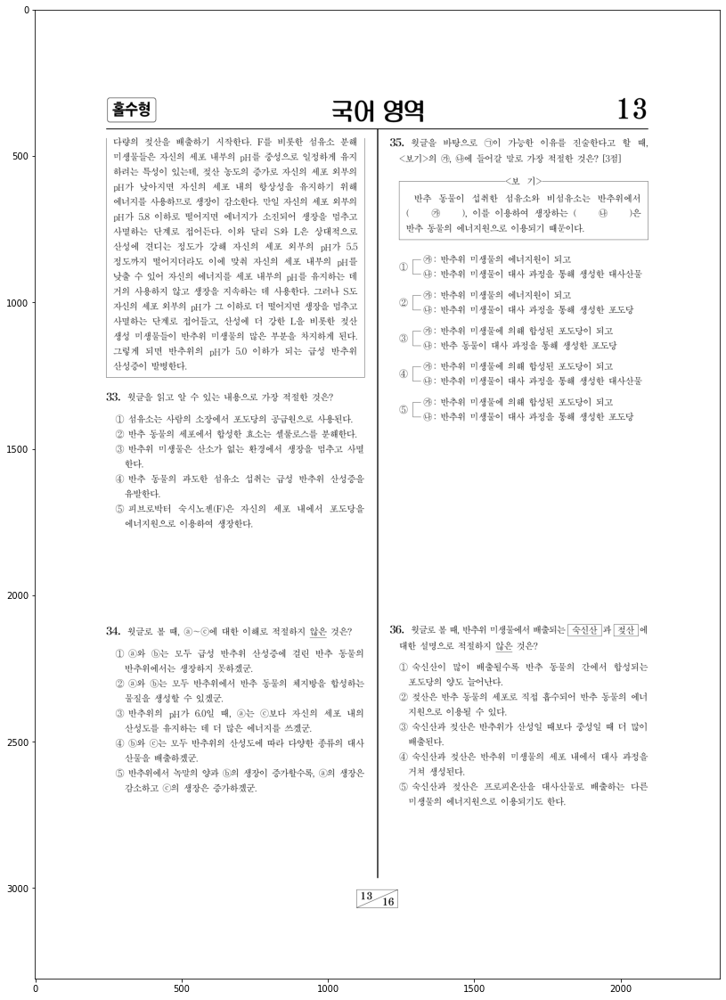

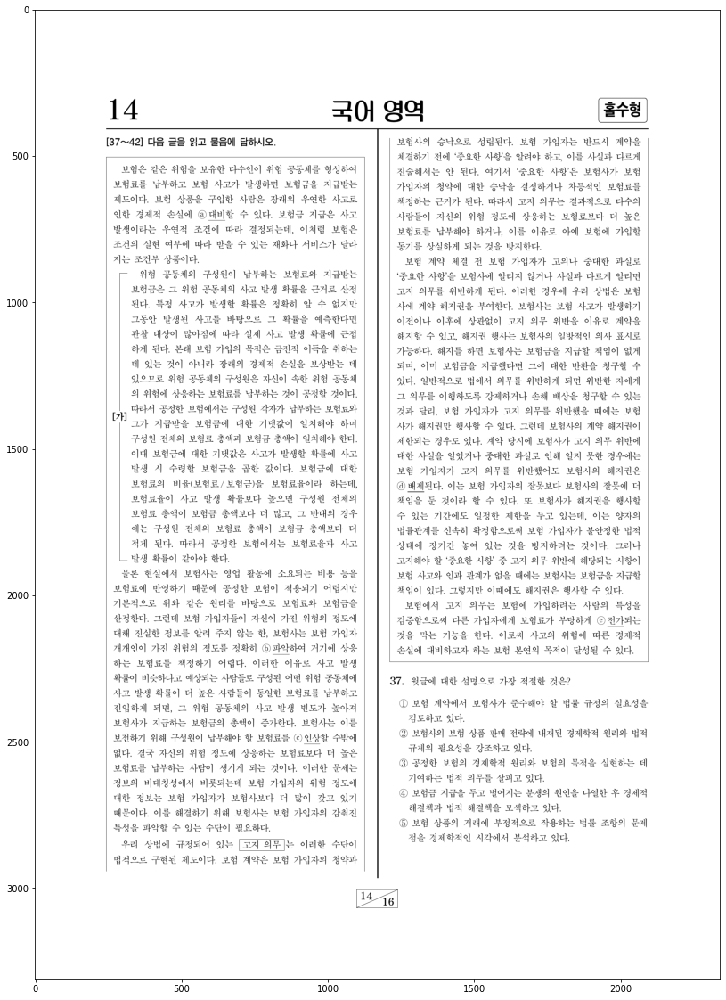

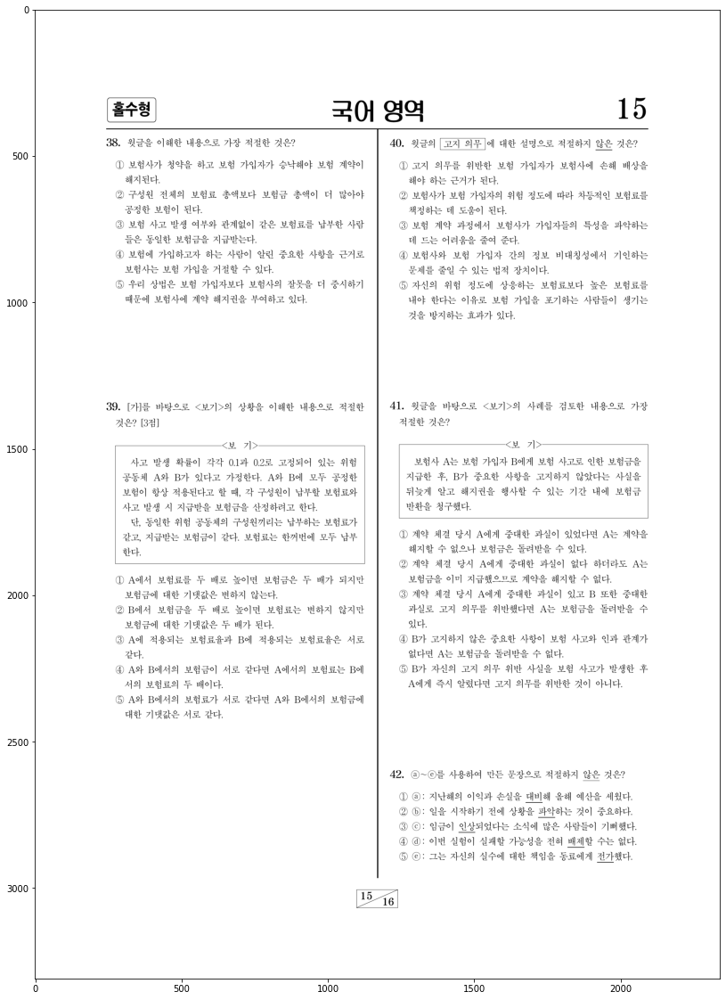

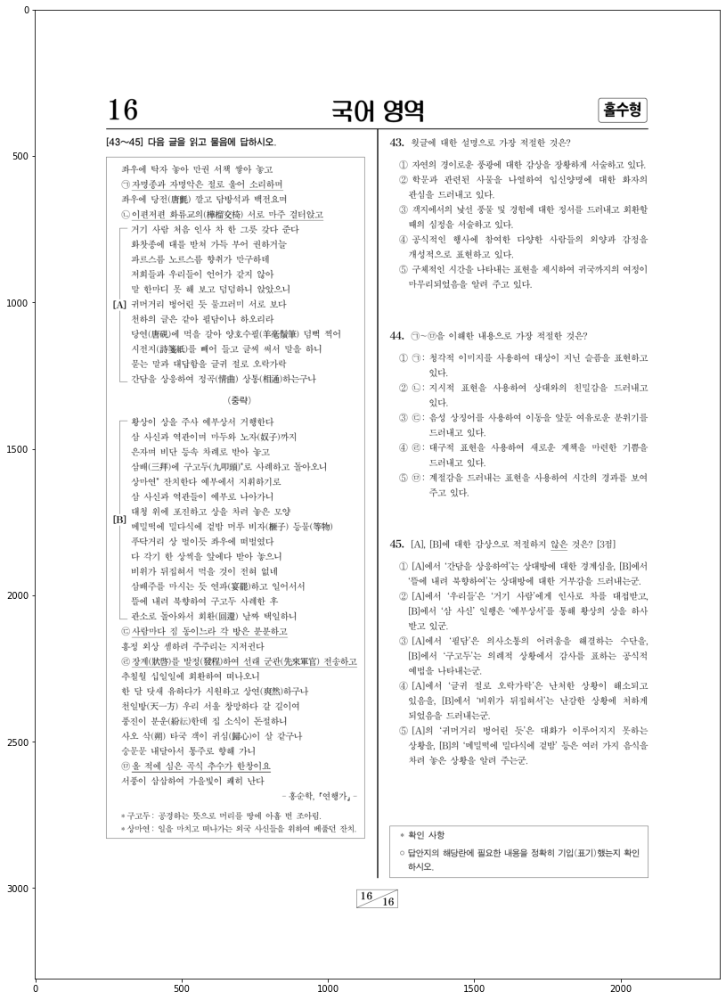

In [515]:
# read png & Load the image
imgs = []
for i in range(pdflen):
    png_path = str(png_dir/(str(i)+".png"))
    img = cv2.imread(png_path)
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    imgs.append(gray)
for img in imgs:
    imshow(img)

In [516]:
# canny preprocessing
thresh1 = 1520
thresh2 = 1000
dst = cv2.Canny(imgs[0], thresh1, thresh2)
cdst = cv2.cvtColor(dst, cv2.COLOR_GRAY2BGR)

# problematic hough
lines = cv2.HoughLinesP(dst, 1, np.pi / 180, 50, None, 100, 20)
print("hough line num :", len(lines))

# extract T lines function
def extract_T(lines):
    '''
    arguments : list([x1,y1,x2,y2])
    return : (max length horizontal line, max length vertical line)
    '''
    xlen = []
    ylen = []
    maxx = 0
    maxy = 0
    for i, line in enumerate(lines):
        x1,y1,x2,y2 = line[0]
        xlen.append(abs(x2-x1))
        ylen.append(abs(y2-y1))
    xi = xlen.index(max(xlen))
    yi = ylen.index(max(ylen))
    return lines[yi], lines[xi]

T = extract_T(lines)
x0,_,x2,_ = T[1][0]

# jimoon box width
jbox_width = int(((x2-x0)/2)*0.85) # T의 width의 절반의 0.85배 이상을 jimoon box 의 width라고 봄

hough line num : 26


In [517]:
def get_xy(word, width, height):
    x0 = word['x0'] / width
    y0 = word['top'] / height
    x1 = word['x1'] / width
    y1 = word['bottom'] / height
    return x0,y0,x1,y1
    


def find_problem_words(words):
    probs = []
    for w in words:
        if w['text'][-1]=='.' and w['text'][:-1].isdigit():
            probs.append(w)
    return probs


def find_jimoon_words(words):
    jimoons = []
    for word in words:
        if word["text"][0] == '[' and word["text"][-1] == ']' and '～' in word['text']:
            jimoons.append(word)
    return jimoons

4
3
6
10
6
3
2
2
4
3
3
4
3
3
3
5


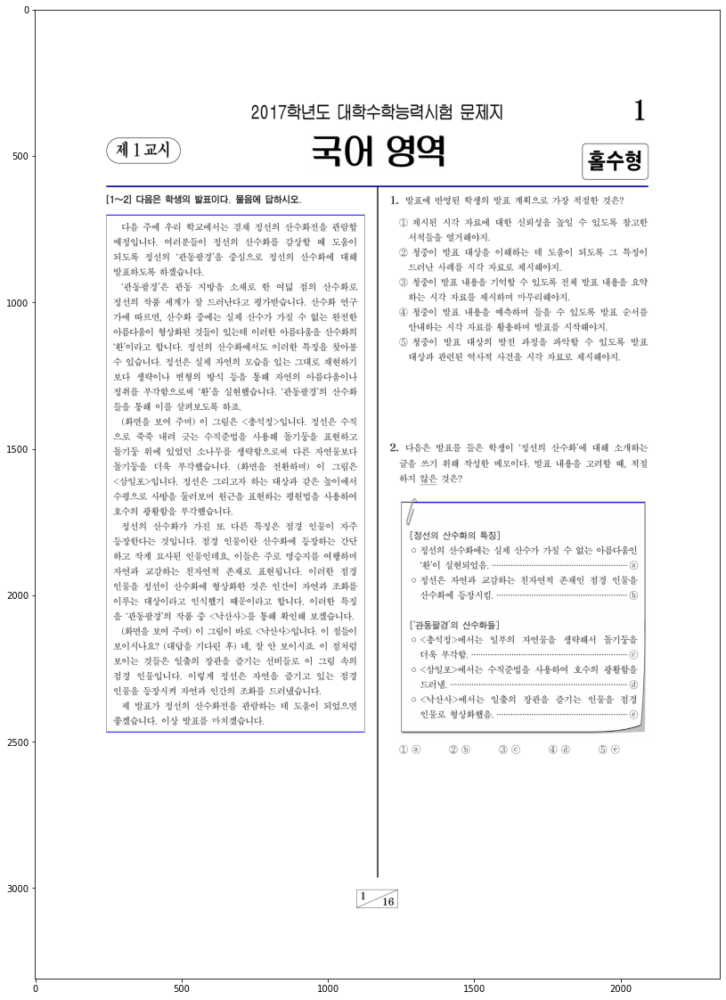

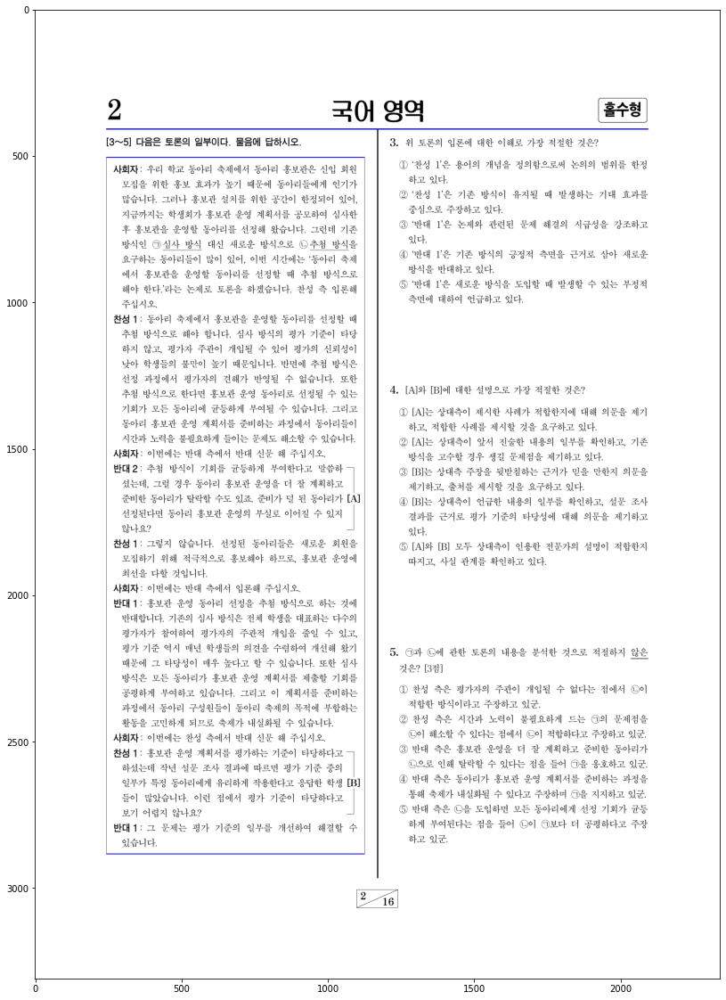

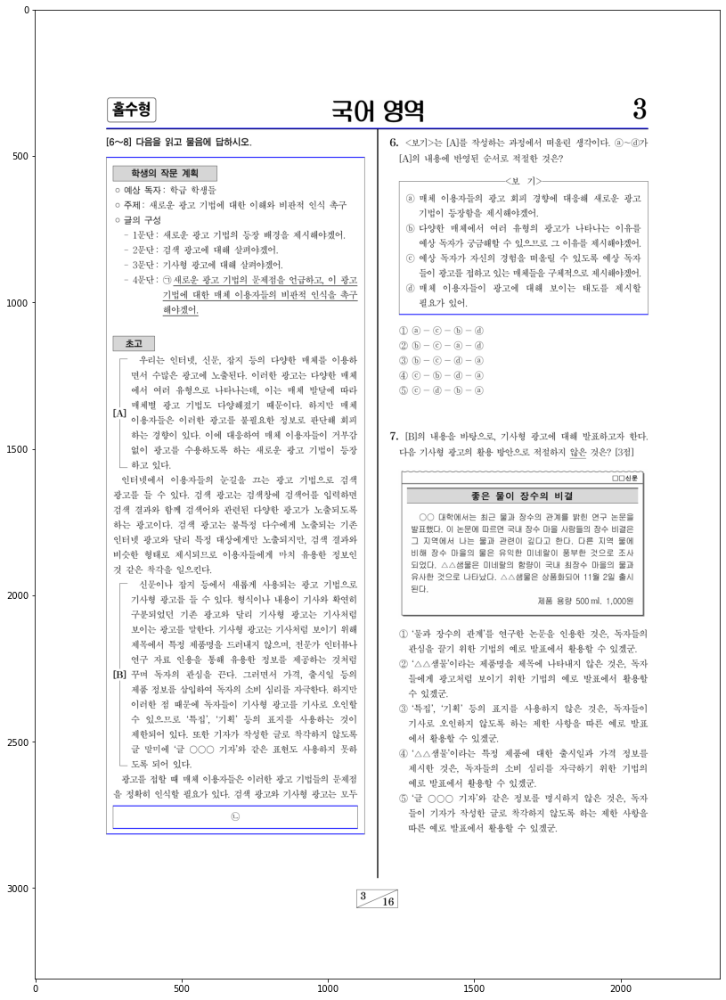

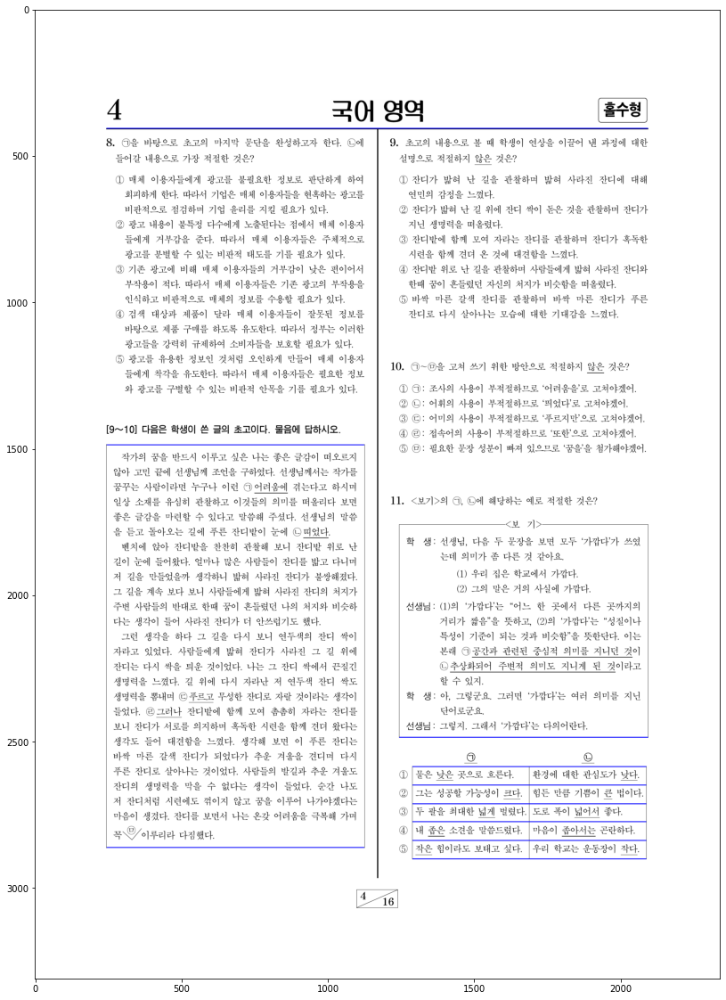

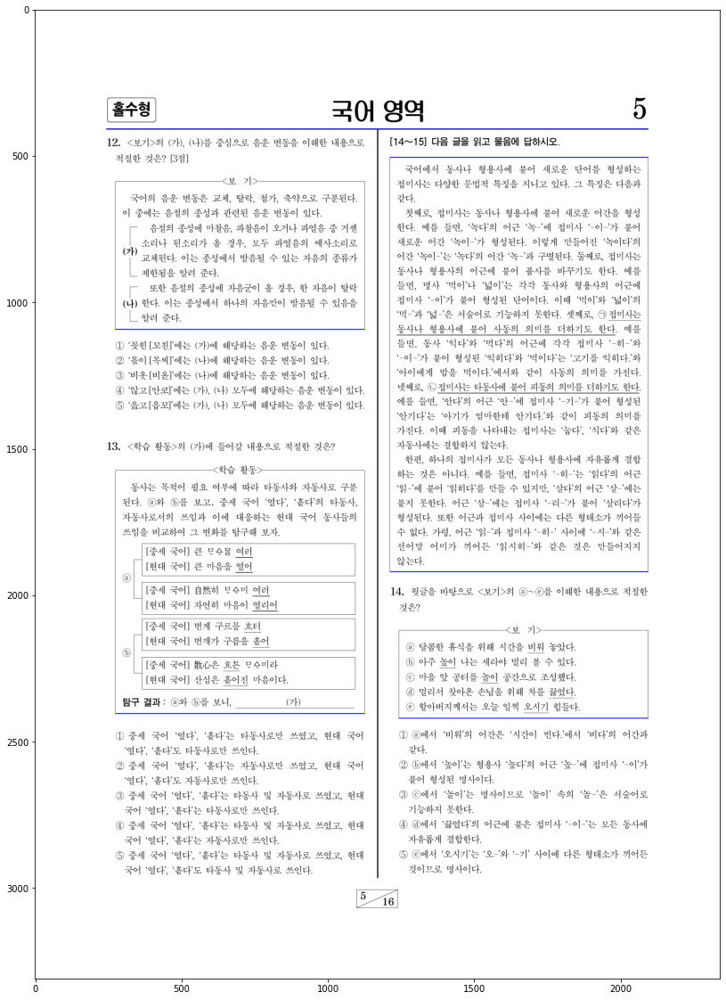

...

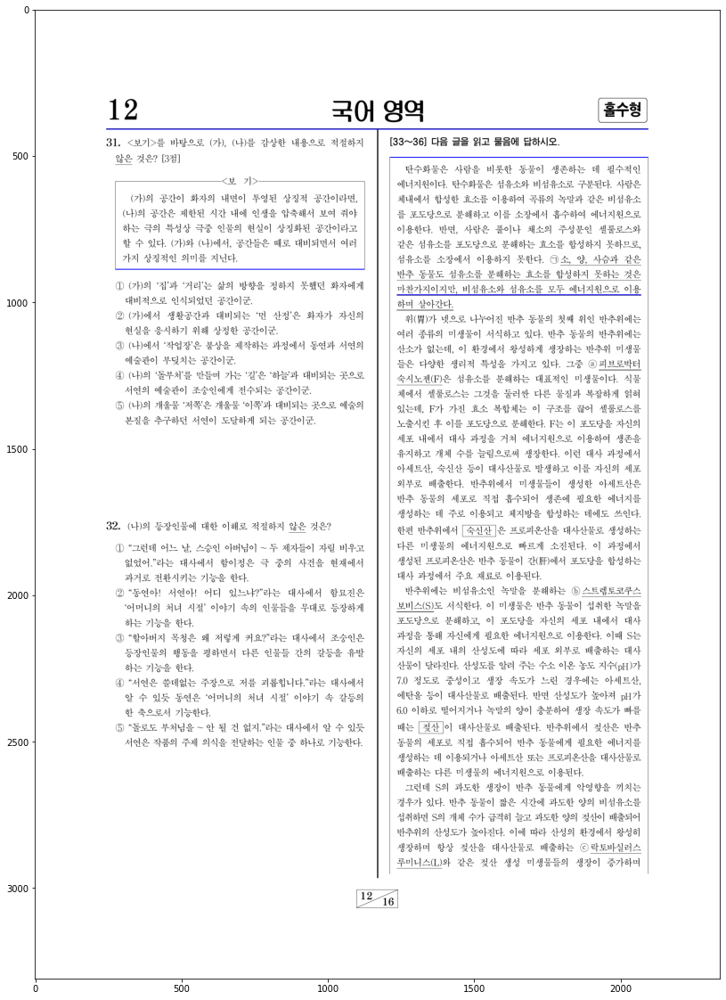

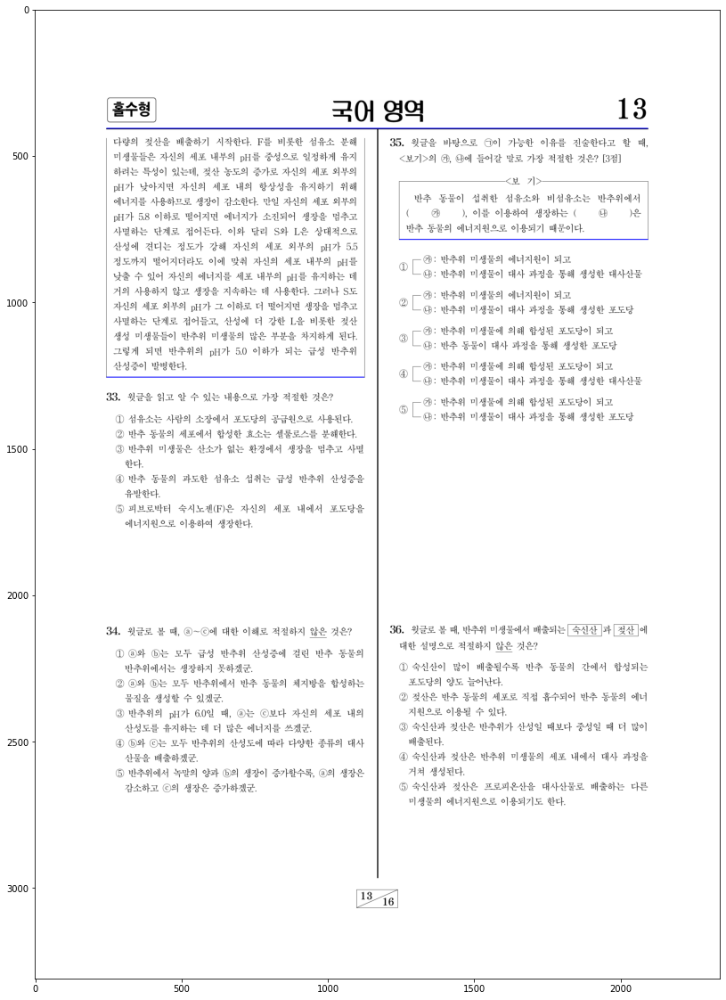

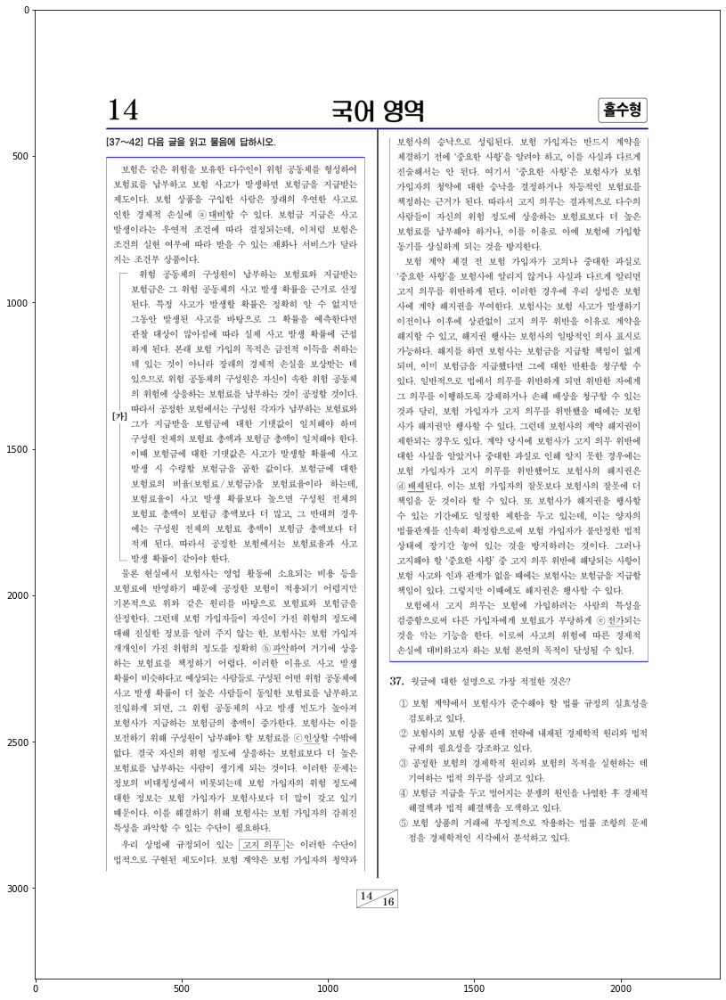

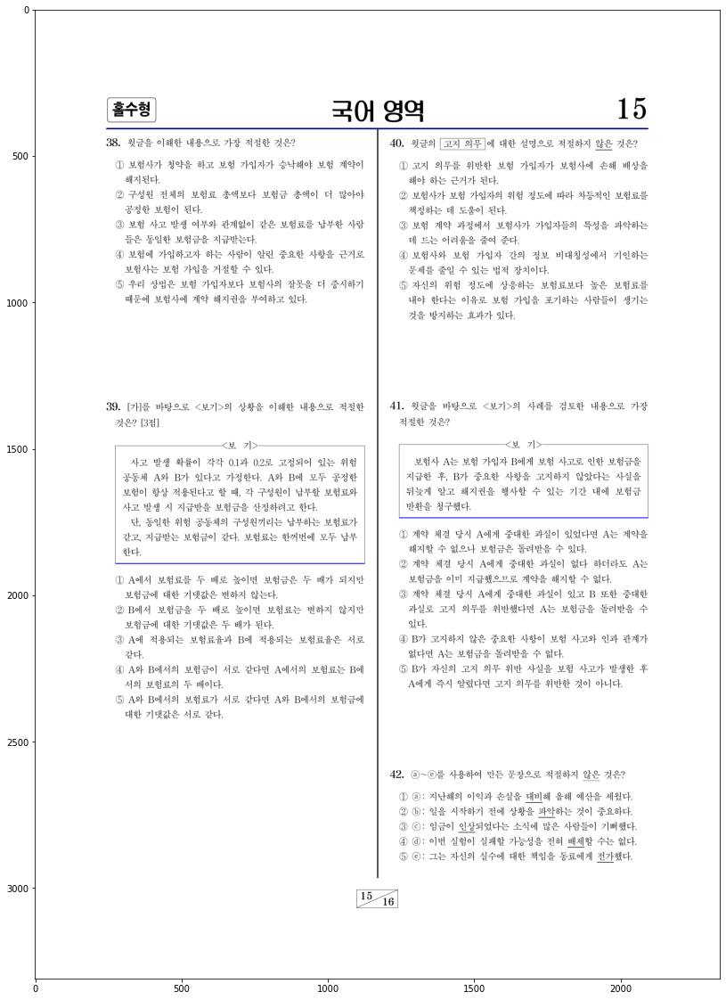

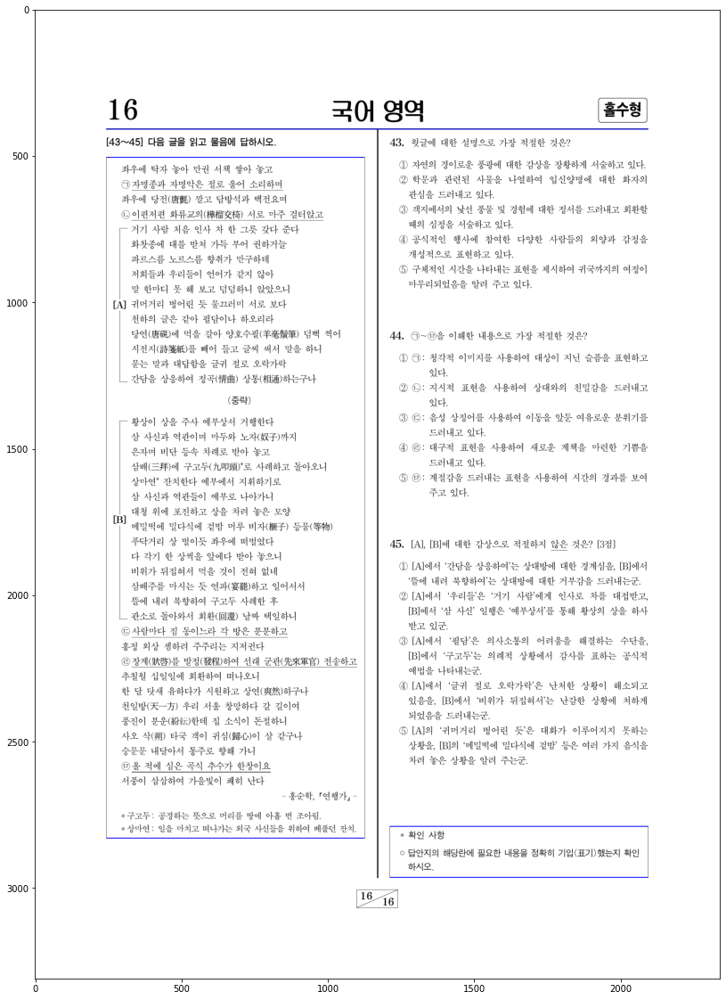

In [518]:
blocks = []
probs_list = []
jimoons_list = []
jbox_lines_list = []
jimoon_names = [] # string
prob_names = [] # string

y_top_padding = 7 # fix pdfplumber position error

with pdfplumber.open(str(pdf_path)) as pdf:
    for i, page in enumerate(pdf.pages):
        img = imgs[i]
        h,w = img.shape
        cimg = cv2.cvtColor(img, cv2.COLOR_GRAY2BGR)
        words = page.extract_words()

        # jimoon
        jimoon_words = find_jimoon_words(words)
        jimoons = []
        for jw in jimoon_words:
            x0,y0,x1,y1 = get_xy(jw, page.width, page.height)
            xys = x0,y0,x1,y1 = int(x0*w), int(y0*h)-y_top_padding, int(x1*w), int(y1*h)
            
            # replace [p0~p1] to [p0-p1]
            jimoon_name = jw['text'][1:-1]
            jimoon_name = jimoon_name.replace('～', '-')
            
            jimoons.append((xys, jimoon_name))

        # problem
        prob_words = find_problem_words(words)
        probs = []
        for pw in prob_words:
            x0,y0,x1,y1 = get_xy(pw, page.width, page.height)
            xys = x0,y0,x1,y1 = int(x0*w), int(y0*h)-y_top_padding, int(x1*w), int(y1*h)
            
            probs.append((xys, pw['text'][:-1])) 
        
        # divide left and right
        # canny preprocess
        thresh1 = 1520
        thresh2 = 1000
        dst = cv2.Canny(img, thresh1, thresh2)

        # problematic hough
        lines = cv2.HoughLinesP(dst, 1, np.pi / 180, 50, None, 100, 20)
        
        # extract T
        T = extract_T(lines)
        x1,y1,_,y0 = T[0][0]
        if y0>y1:
            y0,y1 = y1,y0
        x0,_,x2,_ = T[1][0]
        
        # extract jbox candidates
        jbox_candidates = []
        for l in lines:
            l = l[0]
            if abs(l[2]-l[0]) >= jbox_width:
                overlap = False
                for ll in jbox_candidates:
                    if abs(ll[1]-l[1])<6:
                        overlap = True
                if not overlap:
                    jbox_candidates.append(l)
                    cv2.line(cimg,(l[0],l[1]), (l[2],l[3]), (0,0,255), 2)
        imshow(cimg)
        print(len(jbox_candidates))
        
        # T preprocess (dilate spaces)
        x0 -= 15
        x2 += 15
        y0 += 15
        mid_margin = 25
        
        # divide left&right and preprocess
        for xmin, ymin, xmax, ymax in [(x0, y0, x1-mid_margin, y1), (x1+mid_margin, y0, x2, y1)]:
            blocks.append(img[ymin:ymax, xmin:xmax])
            
            probs_list.append([])
            for prob in probs:
                (x0,y0,x1,y1), name = prob
                if xmin <= x0 < xmax:
                    prob = x0-xmin,y0-ymin,x1-xmin,y1-ymin
                    probs_list[-1].append(prob)
                    prob_names.append(name)
            
            jimoons_list.append([])
            for jimoon in jimoons:
                (x0,y0,x1,y1), name = jimoon
                if xmin <= x0 < xmax:
                    jimoon = x0-xmin,y0-ymin,x1-xmin,y1-ymin
                    jimoons_list[-1].append(jimoon)
                    jimoon_names.append(name)
            
            jbox_lines_list.append([])
            for line in jbox_candidates:
                x0,y0,x1,y1 = line
                if abs(y1-y0)<2 and xmin<=x0<xmax and xmin<=x1<xmax:
                    line = x0-xmin,y0-ymin,x1-xmin,y1-ymin
                    jbox_lines_list[-1].append(line)

        

0 1
2 0
0 1
3 0
0 1
2 0
1 1
3 0
2 0
1 1
1 1
1 0
4 0
0 1
0 0
0 0
2 0
4 0
0 1
0 0
1 0
3 0
2 0
0 1
2 0
2 0
0 1
1 0
2 0
3 0
0 1
3 0


/var/folders/3m/w3td4zd545g6m987tcxfl0k40000gn/T/ipykernel_97098/3873566024.py:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax= plt.subplots(1,1, figsize=figsize)


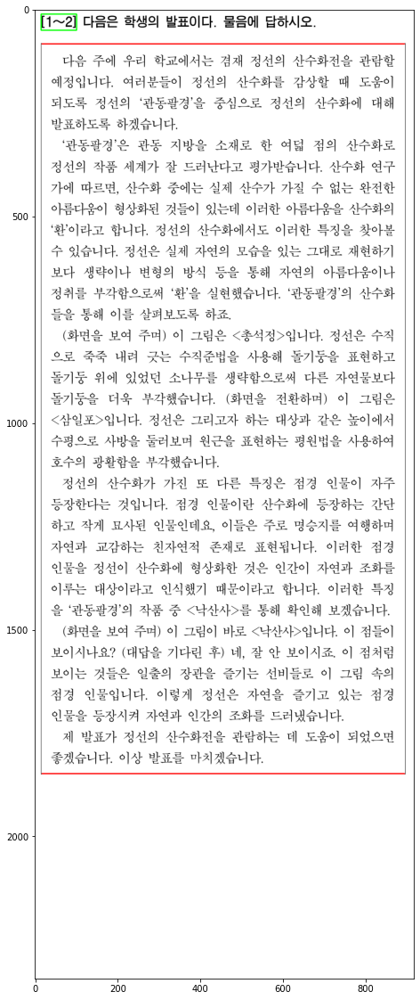

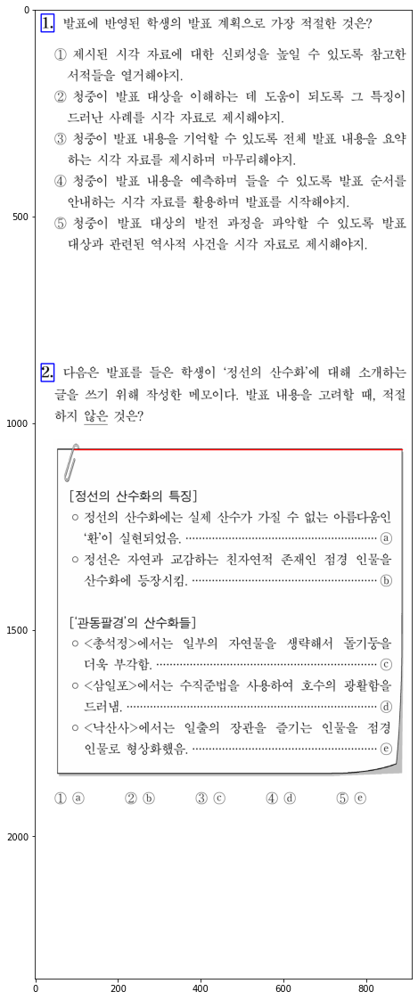

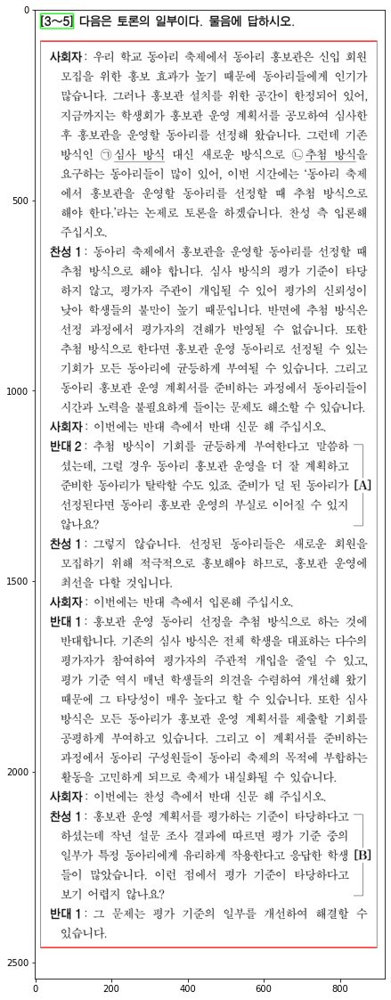

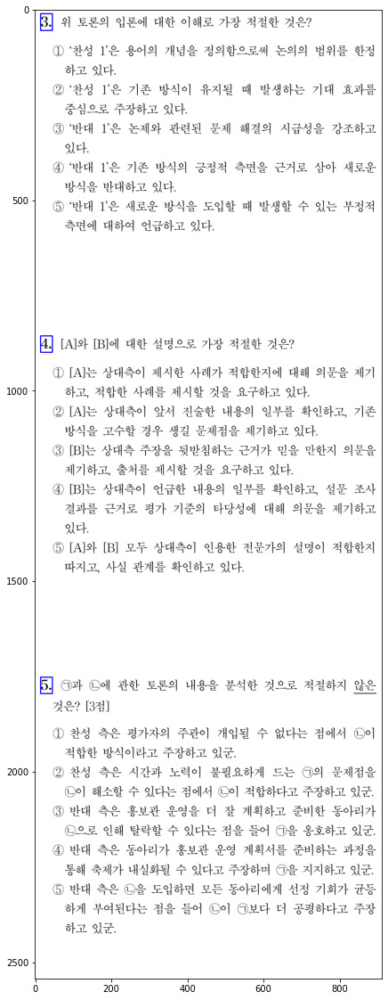

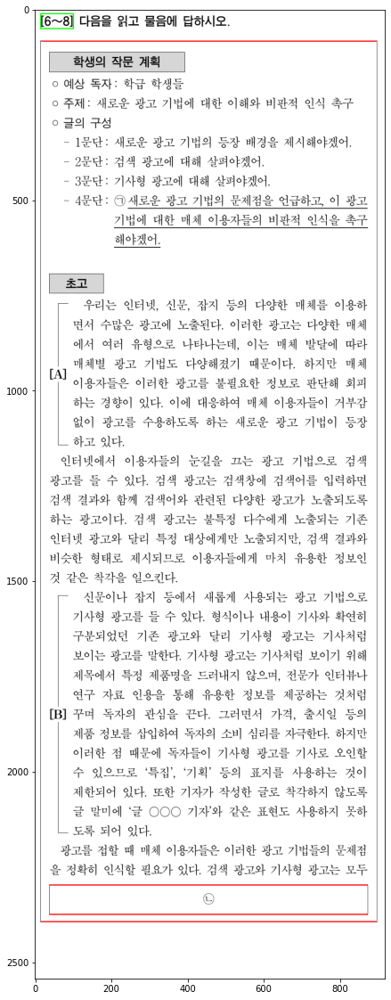

...

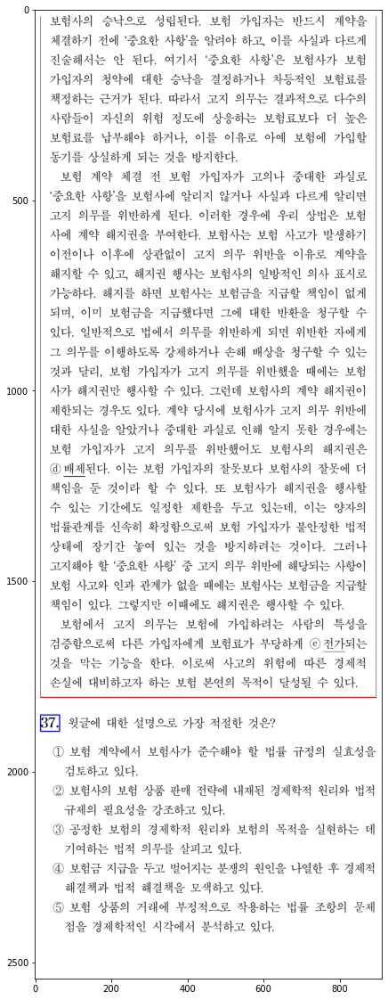

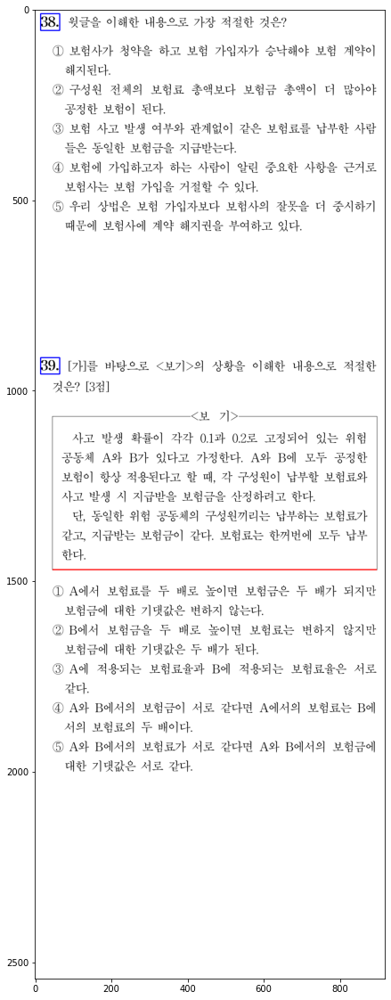

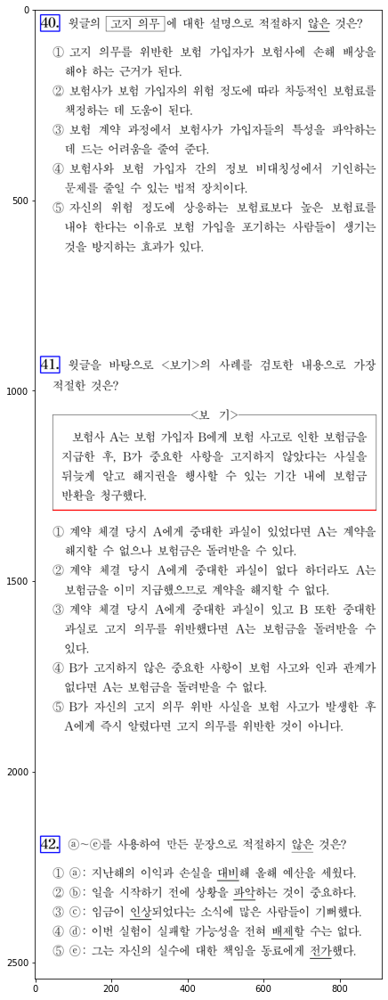

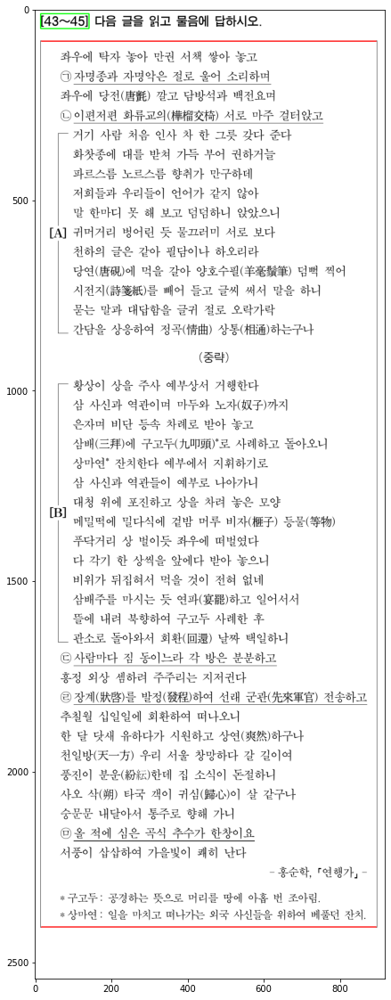

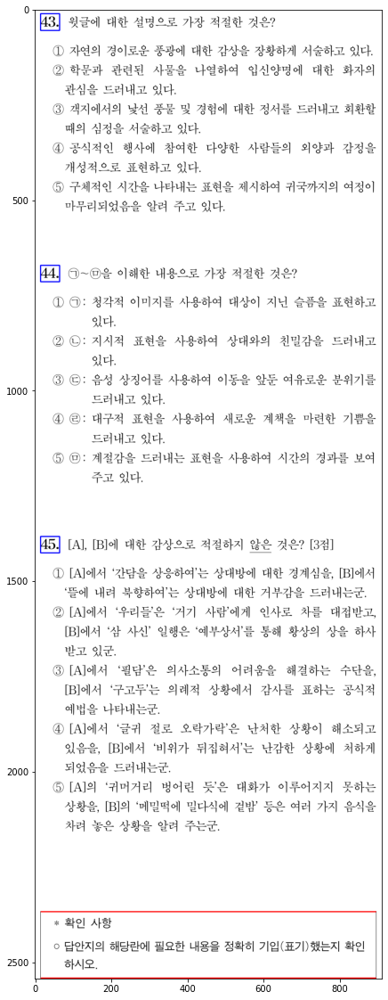

In [519]:
# test
for i, block in enumerate(blocks):
    probs = probs_list[i]
    jimoons = jimoons_list[i]
    jbox_lines = jbox_lines_list[i]
    cb = cv2.cvtColor(block, cv2.COLOR_GRAY2BGR)
    print(len(probs), len(jimoons))
    for prob in probs:
        x0,y0,x1,y1 = prob
        cv2.rectangle(cb, (x0,y0), (x1,y1), (0,0,255), 2)
    for jimoon in jimoons:
        x0,y0,x1,y1 = jimoon
        cv2.rectangle(cb, (x0,y0), (x1,y1), (0,255,0), 2)
    for line in jbox_lines:
        x0,y0,x1,y1 = line
        cv2.line(cb, (x0,y0), (x1,y1), (255,0,0), 2)
    imshow(cb)

In [520]:
# cut blocks list
cutblocks = []
min_width = min([blocks[i].shape[1] for i in range(len(blocks))])
for i in range(len(blocks)):
    blocks[i] = blocks[i][:,:min_width]

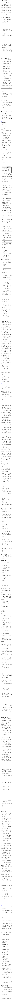

In [521]:
# concatenate
long_block = np.concatenate(blocks)

# concatenate jimoons_list, probs_list, jbox_lines_list
add_height = 0
jimoons = []
tmp_prob_names = [] # to prevent not problem names are included. ex) 보기문의 문장 안에 "3."
probs = []
prob_idx = -1
jbox_lines = []

for i, block in enumerate(blocks):
    
    for x0,y0,x1,y1 in jimoons_list[i]:
        y0+=add_height
        y1+=add_height
        jimoons.append((x0,y0,x1,y1))
        
    for x0,y0,x1,y1 in probs_list[i]:
        prob_idx += 1
        if x0 >= 30: # delete not a problem 
            continue
        y0+=add_height
        y1+=add_height
        probs.append((x0,y0,x1,y1))
        tmp_prob_names.append(prob_names[prob_idx])
        
    for x0,y0,x1,y1 in jbox_lines_list[i]:
        y0+=add_height
        y1+=add_height
        jbox_lines.append((x0,y0,x1,y1))
    add_height += block.shape[0]

# prob_names change
prob_names = tmp_prob_names

# imshow
clb = cv2.cvtColor(long_block, cv2.COLOR_GRAY2BGR)
for x0,y0,x1,y1 in jimoons+probs:
    cv2.rectangle(clb, (x0,y0), (x1,y1), (0,0,255))
imshow(clb, figsize=(10,800))

In [522]:
def make_output_dir(test_name, jimoon_names, probs):
    '''
    description: make output dir according to test year's specific problem structure
    example)
    ## ~2016
    2014/6/A/1-3/p.png
    2014/6/A/1-3/1.png
    2014/6/B/1-3/2.png
    2014/6/B/1-3/3.png
    2014/6/B/4/4.png

    ## 2017~2020
    2020/6/1-3/p.png
    2020/6/1-3/1.png
    2020/6/1-3/2.png
    2020/6/1-3/3.png
    2020/6/4/4.png
    
    ## 2021~
    2021/6/common/1-3/p.png
    2021/6/writing/35-37/37.png
    2021/6/media/35-37/35.png
    '''
    # get test metadata
    tmp = test_name.split('_')
    year = int(tmp[0])
    month = int(tmp[1])
    cat = ''
    if len(tmp)>2:
        cat = tmp[2]
    
    probs_len = 0 # 문제 개수
    test_dir = '' # 모의고사 폴더
    
    # make base dir
    if not os.path.exists(output_dir):
        os.mkdir(output_dir)
    if not os.path.exists(output_dir/str(year)):
        os.mkdir(output_dir/str(year))
    if not os.path.exists(output_dir/str(year)/str(month)):
        os.mkdir(output_dir/str(year)/str(month))
    
    
    # ~2020
    if year<2021:
        probs_len = len(probs)
        
        # ~2016 (A/B)
        if year<2017 and len(cat)!=0:
            test_dir = output_dir/str(year)/str(month)/cat
            # make A/B dir
            if not os.path.exists(test_dir):
                os.mkdir(test_dir)
            

        # 2017~2020 (공통) - (common)
        elif 2017<=year:
            test_dir = output_dir/str(year)/str(month)

        visit = [False]*(probs_len+1)
        visit[0] = True
        for name in jimoon_names:
            if not os.path.exists(test_dir/name):
                os.mkdir(test_dir/name)
            a,b = map(int, name.split('-'))
            for i in range(a, b+1):
                visit[i] = True
        for i, v in enumerate(visit):
            if not v:
                if not os.path.exists(test_dir/str(i)):
                    os.mkdir(test_dir/str(i))
        
    
    # 2021~ (화작/언메) - (writing/media)
    elif 2021<=year:
        
        # make common writing media dir
        if not os.path.exists(output_dir/str(year)/str(month)/'common'):
            os.mkdir(output_dir/str(year)/str(month)/'common')
        if not os.path.exists(output_dir/str(year)/str(month)/'writing'):
            os.mkdir(output_dir/str(year)/str(month)/'writing')
        if not os.path.exists(output_dir/str(year)/str(month)/'media'):
            os.mkdir(output_dir/str(year)/str(month)/'media')
        
        # common
        common_probs_len = 34 # common prob len
        test_dir = output_dir/str(year)/str(month)/'common'
        visit = [False]*(common_probs_len+1)
        visit[0] = True
        for name in jimoon_names:
            a,b = map(int, name.split('-'))
            if a>common_probs_len:
                continue
            if not os.path.exists(test_dir/name):
                os.mkdir(test_dir/name)
            for i in range(a, b+1):
                visit[i] = True
        for i, v in enumerate(visit):
            if not v:
                if not os.path.exists(test_dir/str(i)):
                    os.mkdir(test_dir/str(i))
        
        # writing
        probs_len = 45
        test_dir = output_dir/str(year)/str(month)/'writing'
        visit = [False]*(probs_len+1)
        for i in range(common_probs_len+1):
            visit[i] = True
        old_a = 0
        for name in jimoon_names:
            a,b = map(int, name.split('-'))
            if b<=common_probs_len:
                continue
            if old_a > a:# 지문 index가 40~43 에서 36~37 로 줄어들면 앞으로 media문제들이란 말
                break
            if not os.path.exists(test_dir/name):
                os.mkdir(test_dir/name)
            for i in range(a, b+1):
                visit[i] = True
            old_a = a
        for i, v in enumerate(visit):
            if not v:
                if not os.path.exists(test_dir/str(i)):
                    os.mkdir(test_dir/str(i))
        
        # media
        probs_len = 45
        test_dir = output_dir/str(year)/str(month)/'media'
        visit = [False]*(probs_len+1)
        for i in range(common_probs_len+1):
            visit[i] = True
        old_a = 0
        media = False
        for name in jimoon_names:
            a,b = map(int, name.split('-'))
            if b<=common_probs_len:
                continue
            if old_a > a:# 지문 index가 40~43 에서 36~37 로 줄어들면 앞으로 media문제들이란 말
                media = True
            if media:
                if not os.path.exists(test_dir/name):
                    os.mkdir(test_dir/name)
                for i in range(a, b+1):
                    visit[i] = True
            old_a = a
        for i, v in enumerate(visit):
            if not v:
                if not os.path.exists(test_dir/str(i)):
                    os.mkdir(test_dir/str(i))


def get_contour_ends(long_block):
    '''
    description : make contours
    return : contours' end y value
    '''
    # pre-processing
    _, thresh = cv2.threshold(long_block, 220, 255, cv2.THRESH_BINARY)
    thresh = cv2.bitwise_not(thresh)
    
    kernel = np.ones((15, 25))
    iterations = 5

    thresh = cv2.dilate(thresh, kernel, iterations=iterations)
    thresh = cv2.erode(thresh, kernel, iterations=iterations)
    
    # find the contours
    contours, _ = cv2.findContours(thresh, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    # sort y-axis
    contours = sorted(contours, key=lambda x: cv2.boundingRect(x)[1])
    print(len(contours))
    
    # ends list
    ends = []
    
    for contour in contours:
        (x, y, w, h) = cv2.boundingRect(contour)
        min_width, min_height = 250,250
        if w>=min_width and h>min_height:
            ends.append(int(y+h)+4)
    return ends
    
        

# cut algorithm
def save_jimoon_prob(test_name, long_block, jimoons, jimoon_names, probs, prob_names):
    '''
    preresquite : run make_output_dir() method before run this method
    description : split long block into jimoons and probs and save it into already maden output dir
    save jimoon and prob according to test year's specific problem structure.
    refer to make_output_dir 
    split algorithm is implemented by 3 elements (jimoons, probs, contour_end)
    '''
    contour_ends = get_contour_ends(long_block)
    
    # make elements list with jimoons' y0, probs' y0, contour ends' y value
    # elements : list((y, category, name))
    # element category : jimoon - 0, prob - 1, contour end - 2
    # element name : ex) jimoon - "11-13", prob - "12", contour end - ""
    elements = []
    
    for i, (_,y,_,_) in enumerate(jimoons):
        name = jimoon_names[i]
        elements.append((y,0,name))
    
    for i, (_,y,_,_) in enumerate(probs):
        name = prob_names[i]
        elements.append((y,1,name))
    
    for y in contour_ends:
        elements.append((y,2,''))
    
    elements.sort()
    print(elements)
    
    tmp = test_name.split('_')
    year = int(tmp[0])
    month = int(tmp[1])
    
    test_dir = '' # test output dir 
    
    # ~2020
    if year<2021:
        if len(tmp)==3: 
            # ~2016
            # ex) 2016_9_A
            test_dir = output_dir/str(year)/str(month)/tmp[2]
        else:
            # 2017~2020
            # ex) 2017_9
            test_dir = output_dir/str(year)/str(month)
        
        # split and save
        last_jimoon = "0-0" # check if problem is in lastest jimoon
        for i in range(len(elements)-1):
            y0, cat, name = elements[i]
            y1, _, _ = elements[i+1]
            
            part = long_block[y0:y1,:]
            
            # jimoon
            if cat==0:
                cv2.imwrite(str(test_dir/name/"p.png"), part)
                last_jimoon = name
            
            # problem
            elif cat==1:
                if int(last_jimoon.split('-')[1]) < int(name): # not in last jimoon
                    cv2.imwrite(str(test_dir/name/(name+".png")), part)
                else: # concluded in last jimoon
                    cv2.imwrite(str(test_dir/last_jimoon/(name+".png")), part)

In [523]:
# make output directory structure
make_output_dir(test_name, jimoon_names, probs)

In [524]:
save_jimoon_prob(test_name,long_block, jimoons, jimoon_names, probs, prob_names)

46
[(12, 0, '1-2'), (1854, 2, ''), (2356, 1, '1'), (2932, 2, ''), (3201, 1, '2'), (4271, 2, ''), (4700, 0, '3-5'), (7155, 2, ''), (7243, 1, '3'), (7819, 2, ''), (8088, 1, '4'), (8716, 2, ''), (8983, 1, '5'), (9661, 2, ''), (9786, 0, '6-8'), (12173, 2, ''), (12329, 1, '6'), (13216, 2, ''), (13332, 1, '7'), (14710, 2, ''), (14872, 1, '8'), (15755, 2, ''), (15854, 0, '9-10'), (17305, 2, ''), (17415, 1, '9'), (18042, 2, ''), (18180, 1, '10'), (18500, 2, ''), (18638, 1, '11'), (19887, 2, ''), (19958, 1, '12'), (20898, 2, ''), (20996, 1, '13'), (22501, 0, '14-15'), (24034, 1, '14'), (25044, 1, '15'), (25681, 2, ''), (26004, 0, '16-20'), (29528, 1, '16'), (29899, 2, ''), (30130, 1, '17'), (30912, 2, ''), (31014, 1, '18'), (31589, 2, ''), (31693, 1, '19'), (32370, 2, ''), (32474, 1, '20'), (32673, 0, '21-26'), (40006, 2, ''), (40302, 1, '21'), (40929, 2, ''), (41174, 1, '22'), (42845, 1, '23'), (43472, 2, ''), (43559, 1, '24'), (44134, 2, ''), (44224, 1, '25'), (44799, 2, ''), (44886, 1, '26')